In [1]:
# pip install pandas

In [2]:
# pip uninstall numpy -y

In [3]:
# pip install numpy==1.23.0

In [4]:
# pip install librosa==0.9.0

In [5]:
# pip install --upgrade --force-reinstall matplotlib

In [6]:
# pip uninstall matplotlib -y

In [7]:
# pip install matplotlib==3.8.3

In [8]:
# pip install --upgrade --force-reinstall scipy

In [9]:
# pip cache purge

In [10]:
# pip install --upgrade pip

In [11]:
# pip install --force-reinstall google-pasta

In [12]:
# pip uninstall keras -y

In [13]:
# pip install --upgrade keras --user

In [14]:
# pip uninstall Keras-Applications -y

In [15]:
# pip install Keras-Applications==1.0.8

In [16]:
# pip uninstall Keras-Preprocessing -y

In [17]:
# pip install Keras-Preprocessing==1.1.0

In [18]:
# pip uninstall tensorflow -y

In [19]:
# pip install tensorflow --user

In [20]:
pip show keras

Name: keras
Version: 3.1.1
Summary: Multi-backend Keras.
Home-page: https://github.com/keras-team/keras
Author: Keras team
Author-email: keras-users@googlegroups.com
License: Apache License 2.0
Location: c:\users\kritin\appdata\roaming\python\python39\site-packages
Requires: absl-py, h5py, ml-dtypes, namex, numpy, optree, rich
Required-by: tensorflow-intel
Note: you may need to restart the kernel to use updated packages.


In [21]:
pip show tensorflow

Name: tensorflow
Version: 2.16.1
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: c:\users\kritin\appdata\roaming\python\python39\site-packages
Requires: tensorflow-intel
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [22]:
import sys
print(sys.version)

3.9.19 (main, Mar 21 2024, 17:21:27) [MSC v.1916 64 bit (AMD64)]


In [23]:
# pip install --upgrade --force-reinstall pandas numpy

In [24]:
# pip install --upgrade --force-reinstall numba

In [25]:
# pip install --upgrade --force-reinstall scikit-learn

In [26]:
# pip uninstall Pillow -y

In [27]:
# pip install Pillow

In [28]:
# pip uninstall kiwisolver -y

In [29]:
# pip install kiwisolver

In [30]:
import os
import pandas as pd
import numpy as np
import librosa # For sound processing
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [31]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn import metrics

In [32]:
import tensorflow as tf
from keras.models import Sequential
from keras import layers
from keras import regularizers
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.optimizers import Adam

In [33]:
from tensorflow import keras

In [34]:
from keras.utils import to_categorical

In [35]:
print("Pandas version:", pd.__version__)
print("NumPy version:", np.__version__)

Pandas version: 2.2.1
NumPy version: 1.26.4


In [36]:
print(librosa.__version__)

0.9.0


#### Importing MFCCs

In [37]:
audio_dataset_path = r"C:\\Users\\Kritin\\Desktop\\Imarticus\\Capstone Project 2\\Data\\genres_original"
metadata = pd.read_csv(r"C:\\Users\\Kritin\\Desktop\\Imarticus\\Capstone Project 2\\Data\\features_30_sec.csv")
metadata.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


#### Feature Extraction

Mel Frequency Cepstral Coefficients:

These are state-of-the-art features used in automatic speech and speech recognition studies.

Since the audio signals are constantly changing, first we divide these signals into smaller frames. Each frame is around 20-40 ms long. Then we try to identify different frequencies present in each frame and seperate linguistic frequencies from the noise to discard the noise. It uses the Discrete Cosine Transform (DCT) of these frequencies to keep only a specific sequences of frequencies that have a high probability of information.

In [38]:
def features_extractor(file_name):
    audio, sample_rate = librosa.load(file_name, res_type="kaiser_fast")
    mfccs_features = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40)
    mfccs_scaled_features = np.mean(mfccs_features.T, axis=0)
    
    return mfccs_scaled_features

In [39]:
 metadata.drop(labels=554, axis=0, inplace = True) # Corrupt File

In [40]:
# pip install tqdm

In [41]:
from tqdm import tqdm
# We iterate through every audio file and extract features
# Using Mel-frequency Cepstral Coefficients

extracted_features = []
for index_num, row in tqdm(metadata.iterrows()):
    try:
        final_class_labels = row["label"]
        file_name = os.path.join(os.path.abspath(audio_dataset_path), final_class_labels+"/",str(row["filename"]))
        data = features_extractor(file_name)
        extracted_features.append([data, final_class_labels])
    except Exception as e:
        print(f"Error:{e}")
        continue

999it [00:41, 23.90it/s]


In [42]:
# Converting extracted_features to Pandas dataframe
extracted_features_df = pd.DataFrame(extracted_features, columns = ["feature","class"])
extracted_features_df.head()

,feature,class
0,"[-113.59882, 121.57067, -19.162262, 42.363937,...",blues
1,"[-207.52383, 123.98514, 8.947019, 35.86715, 2....",blues
2,"[-90.757164, 140.44087, -29.084547, 31.686691,...",blues
3,"[-199.57513, 150.08612, 5.663404, 26.855278, 1...",blues
4,"[-160.35417, 126.20948, -35.581394, 22.139256,...",blues


In [43]:
# Splitting the dataset
X = np.array(extracted_features_df["feature"].tolist())
y = np.array(extracted_features_df["class"].tolist())

In [44]:
X.shape

(999, 40)

In [45]:
y.shape

(999,)

In [46]:
# Label Encoding
le = LabelEncoder()
y = to_categorical(le.fit_transform(y))

In [47]:
y.shape

(999, 10)

In [48]:
# Train Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [49]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(799, 40)
(200, 40)
(799, 10)
(200, 10)


#### Model Creation

In [50]:
num_labels = y.shape[1]

In [51]:
model=Sequential()

In [52]:
# Input Layer
model.add(Dense(100,input_shape=(40,), activation = "relu"))
model.add(Dropout(0.3))
# Secound layer
model.add(Dense(200, activation = "relu"))
model.add(Dropout(0.3))
# Third layer
model.add(Dense(100, activation = "relu"))
model.add(Dropout(0.3))

# Output layer
model.add(Dense(num_labels, activation = "softmax"))

In [53]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 100)            │         4,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 200)            │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 100)            │        20,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 10)             │         1,010 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 45,410 (177.38 KB)

 Trainable params: 45,410 (177.38 KB)

 Non-trainable params: 0 (0.00 B)

In [54]:
#optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
model.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer = "rmsprop")

In [55]:
history = model.fit(X_train, y_train, batch_size=32, epochs = 100, validation_data = (X_test, y_test))

Epoch 1/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.1225 - loss: 19.2444 - val_accuracy: 0.2450 - val_loss: 2.7452
Epoch 2/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.1297 - loss: 6.6332 - val_accuracy: 0.2250 - val_loss: 2.0833
Epoch 3/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.1823 - loss: 3.6727 - val_accuracy: 0.1800 - val_loss: 2.2107
Epoch 4/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.2020 - loss: 2.7587 - val_accuracy: 0.1650 - val_loss: 2.2329
Epoch 5/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.2222 - loss: 2.4539 - val_accuracy: 0.1550 - val_loss: 2.2045
Epoch 6/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.2100 - loss: 2.3274 - val_accuracy: 0.2750 - val_loss: 2.0273
Epoch 7/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.2788 - loss: 2.1916 - val_accuracy: 0.3050 - val_loss: 1.9984
Epoch 8/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.2418 - loss: 2.1840 - val_accuracy: 0.3000 -

In [56]:
model.evaluate(X_test, y_test)

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6508 - loss: 1.3684 


[1.348371148109436, 0.625]

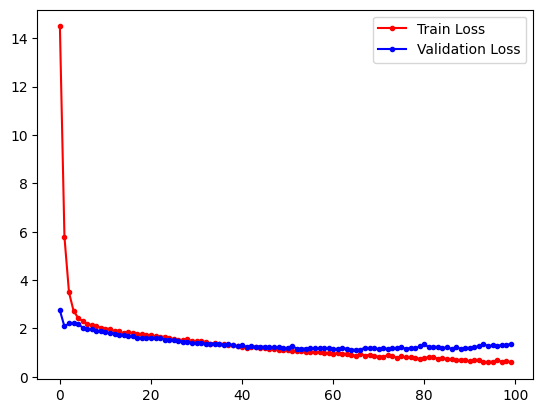

In [57]:
fig, ax = plt.subplots()
ax.plot(history.history["loss"], "r", marker = ".", label = "Train Loss")
ax.plot(history.history["val_loss"], "b", marker = ".", label = "Validation Loss")
ax.legend();

#### Deployment

In [63]:
# Get the unique class labels from your metadata
unique_labels = metadata["label"].unique()

# Create a dictionary for class label mapping (index to label)
class_labels = {index: label for index, label in enumerate(unique_labels)}


# ... (rest of your prediction code)
filename = r"D:\Downloads\Music\Kina - Can We Kiss Forever. (Lyrics) ft. Adriana Proenza.wav"
predicted_feature = features_extractor(filename)
prediction_feature = predicted_feature.reshape(1, -1)
predicted_probabilities = model.predict(prediction_feature)[0]  # Get probabilities
predicted_class_index = np.argmax(predicted_probabilities)  # Find highest probability index
print(predicted_class_index)  # This will print the predicted class (integer)


# Use the mapping to convert the predicted class index
predicted_class_index = np.argmax(predicted_probabilities)  # From previous code

if predicted_class_index in class_labels:
  predicted_label = class_labels[predicted_class_index]
  print(f"Predicted Label: {predicted_label}")
else:
  print(f"Warning: Unknown class index {predicted_class_index}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1
Predicted Label: classical


In [64]:
predicted_probabilities

array([1.66989921e-05, 9.79389012e-01, 1.26513299e-07, 9.89520800e-07,
       2.36983651e-05, 2.05507278e-02, 2.71434070e-10, 4.15179511e-06,
       1.46269385e-05, 2.34684649e-09], dtype=float32)

In [65]:
metadata["label"].unique()

array(['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz',
       'metal', 'pop', 'reggae', 'rock'], dtype=object)

In [66]:
import IPython.display as ipd
import librosa
import librosa.display

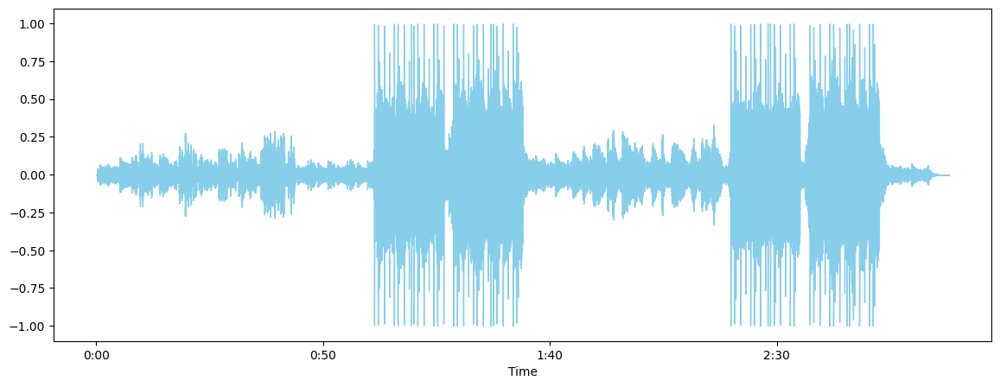

In [67]:
plt.figure(figsize = (14,5))
y, sample_rate = librosa.load(filename)
librosa.display.waveshow(y, sr = sample_rate, color="skyblue")
ipd.Audio(filename)